<a href="https://colab.research.google.com/github/AnnaKarenCasillas/TransferLearning/blob/master/Tarea_Transfer_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Tópicos Selectosa de Inteligencia Artificial: Deep Learning**
## **Tarea: Transfer Learning – Covid-19**

---
#### A00354512 Josue Emanuel Gómez Carrillo
#### A00540988 Luis Francisco González Rodríguez
#### A00354860 Anna Karen Casillas Garcia

---

### Instrucciones

* Descarga las siguientes imágenes de radiografías de torax de personas quee fueron detectadas positivamente con COVID-19. Actualmente no es fácil conseguir una base de datos abierta, pero la siguiente liga nos lleva a la base de datos que está siendo utilizada principalmente a nivel mundial por la comunidad de científicos del área de aprendizaje profundo. Fue recolectada y etiquetada por el Dr. Joseph Paul Cohen (https://josephpcohen.com/w/), uno de los fundadores en 2013 del Institute for Reproducible Research, IRR, (https://reproducibilityinstitute.org/w/). Deberás descargar dicha base de datos y usarla en esta Tarea como el conjunto de imágenes cuya clase está clasificada como positivo para covid19:
https://github.com/ieee8023/COVID-chestxray-dataset/

* Como alternativa para imágenes de radiografías de tórax de personas “normales” se está usando la siguiente base de datos: contiene mucho más imágenes que las de la liga anterior, por lo que deberás decargar la misma cantidad de imágenes de la carpeta llamada “Normal” y usarlas como el conjunto de imágenes clasificadas como covid19 negativo:
https://www.kaggle.com/paultimothymooney/chest-xray-pneumonia

* Se han estado proponiendo arquitecturas muy particulares para este problema. Realiza un breve resumen de la situación actual de esta problemática:
 * European Commission: https://ec.europa.eu/futurium/en/ai-robotics-vs-covid19/covid-19- detector-using-x-ray-images
 * MIT – Technology Review: https://www.technologyreview.es/s/12049/una-nueva-ia-podria- detectar-el-covid-19-en-una-radiografia-de-torax
 * COVID-Net: https://arxiv.org/abs/2003.09871
 * https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7187882/

## 1. Realiza un breve resumen de cada una de las siguientes arquitecturas CNN: 


 * a. VGG
 * b. ResNet
 * c. Xception
 * d. Inception/GoogleLeNet 
 * e. InceptionResNet
 * f. MobileNet
 * g. DenseNet
 * h. NasNetMobile
 * i. EfficientNet


 ### El Resumen de cada una de las arquitecturas CNN puede encontrasr en el siguiente link: [Arquitecturas CNN](https://docs.google.com/document/d/143J4s2d9U8Dw3E0-X3E6lUpgshuys22TkdPaII1Gx2o/edit?usp=sharing)

## 2. Implementa cada una de las arquitecturas anteriores usando únicamente los pesos pre-entrenados de su bloque convolucional (include_top=False), para el conjunto de imágenes covid19 vs normal. 
Inicia con el modelo más simple cuando existan varias versiones de algunos de ellos. Deberás proponer las capas de salida (layers) que consideres adecuadas en cada caso para el llamado bloque de clasificación. En cada uno de los modelos del problema anterior deberás incluir como mínimo:
* a. Resumen de las características principales del modelo: Partición utilizada, método de optimización, tamaño de batches, tasa de aprendizaje, etc.
* b. Resumen de la arquitectura propuesta.
* c. Tamaño de las imágenes de entrada.
* d. Total de pesos del modelo propuesto y tamaño en MB del mismo.
* e. Tiempo de entrenamiento.
* f. Resumen numérico: precision, recall, f 1-score y matriz de confusión.
* g. Gráficas de la precisión (accuracy) y del error de los conjuntos de entrenamiento y
prueba.


###Cargado de imágenes COVID

### Pre-requisitos



Para poder ejecutar este proyecto necesitaremos imágenes montadas en tu Google Drive:
1. Descarga el siguiente archivo y colocarlo en la raíz de su Google Drive
https://drive.google.com/open?id=1cI3xqqG4HvZdrtPGWssowI0M1H0LkCVe

2. 
```
My Drive/
     ├──xray.zip
```


### 0. Instalar la versión más reciente de Tensor Flow en Google Colab

In [0]:
# To determine which version you're using:
!pip show tensorflow

#!pip install --upgrade tensorflow
!pip install tf-nightly

Name: tensorflow
Version: 2.2.0
Summary: TensorFlow is an open source machine learning framework for everyone.
Home-page: https://www.tensorflow.org/
Author: Google Inc.
Author-email: packages@tensorflow.org
License: Apache 2.0
Location: /usr/local/lib/python3.6/dist-packages
Requires: wheel, tensorboard, opt-einsum, google-pasta, tensorflow-estimator, six, scipy, grpcio, gast, h5py, termcolor, absl-py, keras-preprocessing, protobuf, astunparse, wrapt, numpy
Required-by: fancyimpute
     |████████████████████████████████| 525.1MB 30kB/s 
     |████████████████████████████████| 2.9MB 38.4MB/s 
     |████████████████████████████████| 460kB 40.1MB/s 


### 1. Montar Google Drive a la sesión actual

In [0]:
#Montar Google Drive en la sesion actual
#Google Solicitará permiso para acceder a tu drive
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
#Descomprimir archivo de imágenes
!unzip -q "/content/drive/My Drive/xray.zip"

!ls

drive  __MACOSX  sample_data  xray


Después de descomprimir el archivo zip, la estructura de folders debe aparecer así:

```
 ├──xray
      ├── covid/
      └── normal/
```



In [0]:
#Verificar que si esté montado el Drive con el path correcto
!ls '/content/xray'

#Output esperado:
# /content/xray
# covid  normal

/content/xray
covid  normal


###2. Creación de Dataset de Imágenes

In [0]:
#Ubicación de las imágenes
mypath = '/content/xray'
print(mypath)


/content/xray


In [0]:
import matplotlib
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing import image_dataset_from_directory

##Variables de imágen
image_size = (224, 224)
batch_size = 32

train_ds = tf.keras.preprocessing.image_dataset_from_directory(
    mypath,
    labels="inferred",
    class_names=['covid', 'normal'],
    color_mode="rgb",
    label_mode= "categorical",
    seed=1337,
    validation_split = 0.2,
    subset = "training",
    image_size=image_size,
    batch_size=batch_size,
)

validation_ds = tf.keras.preprocessing.image_dataset_from_directory(
    mypath,
    labels="inferred",
    class_names=['covid', 'normal'],
    color_mode="rgb",
    label_mode= "categorical",
    seed=1337,
    validation_split = 0.2,
    subset = "validation",
    image_size=image_size,
    batch_size=batch_size,
)

Found 878 files belonging to 2 classes.
Using 703 files for training.
Found 878 files belonging to 2 classes.
Using 175 files for validation.


### Mostrando ejemplos del DataSet con sus etiquetas

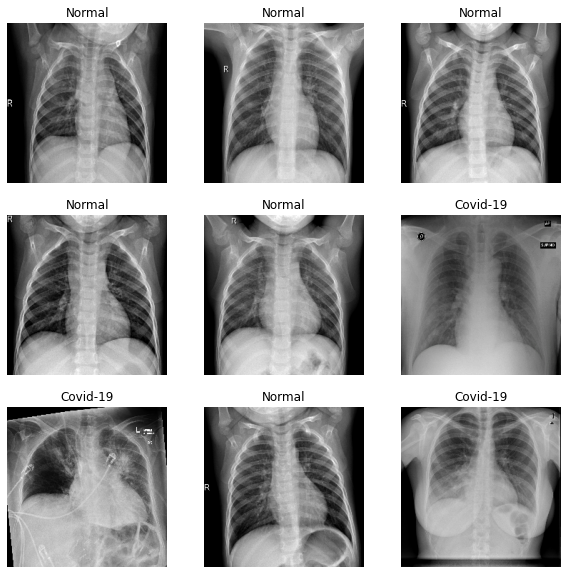

In [0]:
#Mostrando ejemplos del DataSet con sus etiquetas

limit=9
i=0
plt.figure(figsize=(10, 10))

for e in train_ds:
  label = e[1][0].numpy().astype("int")
  if (label[0] == 1):
    label = "Covid-19"
  else:
    label = "Normal"
  if i < limit:
    ax = plt.subplot(3, 3, i+1)
    plt.imshow(e[0][0].numpy().astype("uint8"))
    plt.title(label)
    plt.axis("off")
    i+=1
  else:
    break

# [1 0] COVID-19
# [0 1] NORMAL

In [0]:
#Código en común para el proyecto.
import matplotlib
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
import time


#Plot function to be reused to plot model's Accuracy and Loss
def plotAccuLost(model_H, epochs):
  plt.style.use("ggplot")
  #First Plot Training and Validation Accuracy
  plt.figure()
  plt.plot(np.arange(0,epochs),model_H.history["accuracy"],label="train_acc")
  plt.plot(np.arange(0,epochs),model_H.history["val_accuracy"],label="val_acc")
  plt.title("Training and Validation Accuracy")
  plt.xlabel("Epoch")
  plt.ylabel("Accuracy")
  plt.legend()
  #Second Plot Training and Validation Lioss
  plt.figure()
  plt.plot(np.arange(0,epochs),model_H.history["loss"],label="train_loss") 
  plt.plot(np.arange(0,epochs),model_H.history["val_loss"],label="val_loss")
  plt.title("Training and Validation Loss")
  plt.xlabel("Epoch")
  plt.ylabel("Loss")
  plt.legend()
  #Print Plot
  plt.show()


### A. VGG

Este modelo sencillo demostró un gran desempeño, se probaron varias combinaciones de optimizadores (ADAM, SGD y NADAM). SGD mostró los mejores resultados.

Notese el largo tiempo de entrenamiento debido a que no se utilizó GPU sino hasta casi al final del proyecto. Cabe mencionar que aunque un inconveniente fue bastante didactico vivir en carne propia la enorme mejoría que significa utilizar GPUs sobre CPUs convencionales.

#### Final VGG

##### a. Resumen de las características principales del modelo: Partición utilizada, método de optimización, tamaño de batches, tasa de aprendizaje, etc.


**VGG16**
* Batch Size: 64
* Optimimizador: SGD
* Función de Loss: Binary Cross-Entropy
* Weights: imagenet
* Pooling: GlobalAveragePooling2D
* Dropout(0.5)
* NN Layers: 100, activation = relu
* Classification classes: 2,  activation: softmax
* Epochs: 10

In [0]:
#VGG Model
# https://keras.io/api/applications/vgg/#vgg16-function
from tensorflow import keras

#Variables del modelo
vgg_n_epochs = 10
vgg_optimizer = keras.optimizers.SGD()
vgg_loss = keras.losses.BinaryCrossentropy()

#Definicióón de la base VGG
#Original
#vgg_model = keras.applications.VGG16(include_top=True, weights=None, input_shape=(224,224,3),pooling="avg", classes=2)
base_model = tf.keras.applications.VGG16(include_top=False, weights='imagenet', input_shape=(224,224,3))
base_model.trainable = False

x = base_model.output
# Adicionando capas de classificion
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(100, activation='relu')(x)
num_classes = 2
predictions = tf.keras.layers.Dense(num_classes, activation='softmax')(x)

vgg_model = tf.keras.Sequential()

vgg_model = tf.keras.models.Model(inputs=base_model.input, outputs=predictions)
#Compile
vgg_model.compile(optimizer=vgg_optimizer, loss=vgg_loss, metrics=['accuracy'])

In [0]:
#Entrenar modelo e imprimir tiempos
vgg_t = time.process_time()
vgg_H = vgg_model.fit(train_ds, epochs=vgg_n_epochs, validation_data=test_ds)
print("Tiempo Total (segs) = ", time.process_time() - vgg_t)

Epoch 1/10
11/11 [==============================] - 426s 39s/step - loss: 1.4296 - accuracy: 0.7838 - val_loss: 0.0898 - val_accuracy: 0.9714
Epoch 2/10
11/11 [==============================] - 436s 40s/step - loss: 0.4899 - accuracy: 0.8819 - val_loss: 0.1274 - val_accuracy: 0.9714
Epoch 3/10
11/11 [==============================] - 425s 39s/step - loss: 0.3033 - accuracy: 0.9104 - val_loss: 0.1389 - val_accuracy: 0.9371
Epoch 4/10
11/11 [==============================] - 414s 38s/step - loss: 0.2556 - accuracy: 0.9275 - val_loss: 0.0546 - val_accuracy: 0.9714
Epoch 5/10
11/11 [==============================] - 414s 38s/step - loss: 0.2306 - accuracy: 0.9331 - val_loss: 0.0390 - val_accuracy: 0.9886
Epoch 6/10
11/11 [==============================] - 427s 39s/step - loss: 0.1531 - accuracy: 0.9459 - val_loss: 0.0360 - val_accuracy: 0.9886
Epoch 7/10
11/11 [==============================] - 432s 39s/step - loss: 0.1760 - accuracy: 0.9431 - val_loss: 0.0466 - val_accuracy: 0.9829
Epoch 

##### b. Resumen de la arquitectura propuesta.

###### VGG model (graphic)

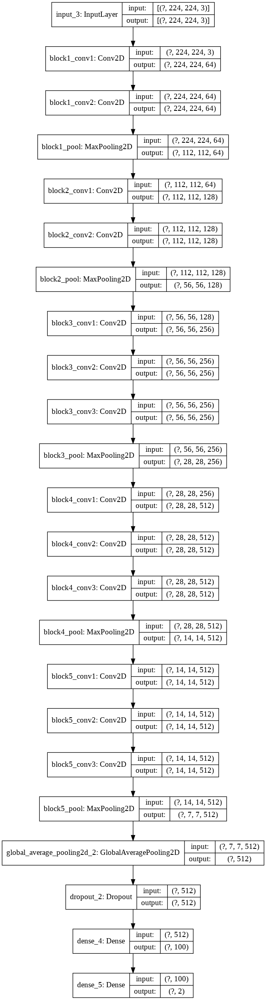

In [0]:
keras.utils.plot_model(vgg_model, show_shapes=True)

###### VGG model summary



In [0]:
vgg_model.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)      

##### c. Tamaño de las imágenes de entrada.

**Decidimos un tamaño consistente de entrada 234x234x3**

##### d. Total de pesos del modelo propuesto y tamaño en MB del mismo.

###### VGG model weight in MB

In [0]:
vgg_model.save("vgg_xfer_mark1.hdf5")

 **56.4 Mb**

###### VGG model weights

In [0]:
vgg_model_weights = vgg_model.get_weights()
print(vgg_model_weights)

[array([[[[ 4.29470569e-01,  1.17273867e-01,  3.40129584e-02, ...,
          -1.32241577e-01, -5.33475243e-02,  7.57738389e-03],
         [ 5.50379455e-01,  2.08774377e-02,  9.88311544e-02, ...,
          -8.48205537e-02, -5.11389151e-02,  3.74943428e-02],
         [ 4.80015397e-01, -1.72696680e-01,  3.75577137e-02, ...,
          -1.27135560e-01, -5.02991639e-02,  3.48965675e-02]],

        [[ 3.73466998e-01,  1.62062630e-01,  1.70863140e-03, ...,
          -1.48207128e-01, -2.35300660e-01, -6.30356818e-02],
         [ 4.40074533e-01,  4.73412387e-02,  5.13819456e-02, ...,
          -9.88498852e-02, -2.96195745e-01, -7.04357103e-02],
         [ 4.08547401e-01, -1.70375049e-01, -4.96297423e-03, ...,
          -1.22360572e-01, -2.76450396e-01, -3.90796512e-02]],

        [[-6.13601133e-02,  1.35693997e-01, -1.15694344e-01, ...,
          -1.40158370e-01, -3.77666801e-01, -3.00509870e-01],
         [-8.13870355e-02,  4.18543853e-02, -1.01763301e-01, ...,
          -9.43124294e-02, -5.056

##### e. Tiempo de entrenamiento

**Tiempo Total (segs) =  8975.674916167 - (1h 29m)**

##### f. Resumen numérico: precision, recall, f 1-score y matriz de confusión.

###### Preparamos los datos para obtener los valores con sklearn

In [0]:
###### Separamos las Imágenes y los labels del set de pruebas
r = []
i = []
#for each batch
for batch in test_ds:
  #for each label
  for label in batch[1]:
    toInt = label.numpy().astype(int)
    r.append(toInt)
  #for each image
  for image in batch[0]:
    toUint = image.numpy().astype("uint8")
    i.append(toUint)

labels = np.array(r)
images = np.array(i)
print(labels.shape)
print(images.shape)

(175, 2)
(175, 224, 224, 3)


###### Resumen númerico de precisión modelo


In [0]:
###### Resumen númerico de precision modelo vgg
from sklearn.metrics import classification_report
label_names = ["Covid","Normal"]
predictions_test = vgg_model.predict(images, batch_size=64)
print(classification_report(labels.argmax(axis=1),
      predictions_test.argmax(axis=1), target_names=label_names))

              precision    recall  f1-score   support

       Covid       1.00      0.95      0.97        80
      Normal       0.96      1.00      0.98        95

    accuracy                           0.98       175
   macro avg       0.98      0.97      0.98       175
weighted avg       0.98      0.98      0.98       175



###### Matriz de Confusión

In [0]:
from sklearn.metrics import confusion_matrix
confusion_matrix(labels.argmax(axis=1), predictions_test.argmax(axis=1))

array([[76,  4],
       [ 0, 95]])

##### g. Gráficas de la precisión (accuracy) y del error de los conjuntos de entrenamiento y prueba.

###### Gráficas de desempeño

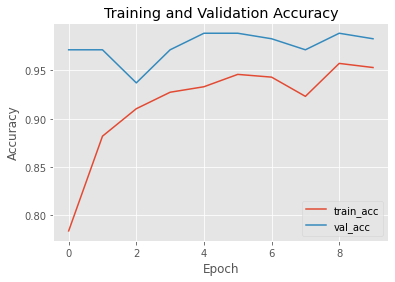

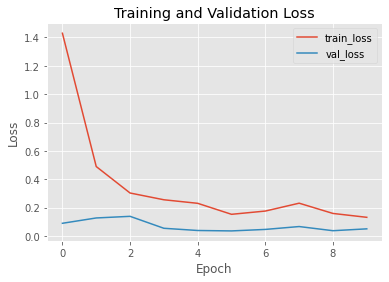

In [0]:
plotAccuLost(vgg_H, vgg_n_epochs)

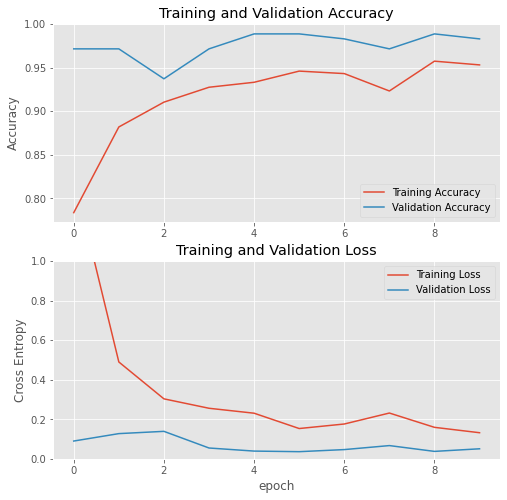

In [0]:
history = vgg_H
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

###B. ResNet

####a. Resumen de las características principales del modelo: Partición utilizada, método de optimización, tamaño de batches, tasa de aprendizaje, etc.


In [0]:
import matplotlib
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing import image_dataset_from_directory

#Ubicación de las imágenes
mypath = '/content/xray'
print(mypath)

##Variables de imágen
image_size = (224, 224) #image size
batch_size = 32 #baches size
n_epochs = 10 # # epochs

train_ds = tf.keras.preprocessing.image_dataset_from_directory(
    mypath,
    labels="inferred",
    class_names=['covid', 'normal'],
    color_mode="rgb",
    label_mode= "categorical",
    seed=1337,
    validation_split = 0.2,
    subset = "training",
    image_size=image_size,
    batch_size=batch_size,
)

val_ds = tf.keras.preprocessing.image_dataset_from_directory(
    mypath,
    labels="inferred",
    class_names=['covid', 'normal'],
    color_mode="rgb",
    label_mode= "categorical",
    seed=1337,
    validation_split = 0.2,
    subset = "validation",
    image_size=image_size,
    batch_size=batch_size,
)

/content/xray
Found 878 files belonging to 2 classes.
Using 703 files for training.
Found 878 files belonging to 2 classes.
Using 175 files for validation.


In [0]:
#Plot function to be reused to plot model's Accuracy and Loss
def plotAccuLost(model_H, epochs):
  plt.style.use("ggplot")
  #First Plot Training and Validation Accuracy
  plt.figure()
  plt.plot(np.arange(0,epochs),model_H.history["accuracy"],label="train_acc")
  plt.plot(np.arange(0,epochs),model_H.history["val_accuracy"],label="val_acc")
  plt.title("Training and Validation Accuracy")
  plt.xlabel("Epoch")
  plt.ylabel("Accuracy")
  plt.legend()
  #Second Plot Training and Validation Lioss
  plt.figure()
  plt.plot(np.arange(0,epochs),model_H.history["loss"],label="train_loss") 
  plt.plot(np.arange(0,epochs),model_H.history["val_loss"],label="val_loss")
  plt.title("Training and Validation Loss")
  plt.xlabel("Epoch")
  plt.ylabel("Loss")
  plt.legend()
  #Print Plot
  plt.show()

In [0]:
#Separamos las Imágenes y labels del set de val
l = []
i = []
#for each bach
for image,label in val_ds.unbatch():
  l.append(label.numpy().astype(int))
  i.append(image.numpy().astype(int))
val_y = np.array(l)
val_x = np.array(i)
print(val_y.shape)
print(val_x.shape)

(175, 2)
(175, 224, 224, 3)


In [0]:
#Separamos las Imágenes y labels del set de train
l = []
i = []
#for each bach
for image,label in train_ds.unbatch():
  l.append(label.numpy().astype(int))
  i.append(image.numpy().astype(int))

train_y = np.array(l)
train_x = np.array(i)
print(train_y.shape)
print(train_x.shape)

(703, 2)
(703, 224, 224, 3)


In [0]:
# Creamos el modelo base ResNet50v2
base_model = tf.keras.applications.ResNet50(input_shape=image_dimension,
                                               include_top=False,weights='imagenet')
base_model.trainable = False

94773248/94765736 [==============================] - 1s 0us/step


In [0]:
feature_batch = base_model(train_x)
print(feature_batch.shape)

(703, 7, 7, 2048)


In [0]:
base_model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_20 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_20[0][0]                   
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
___________________________________________________________________________________________

In [0]:
x = base_model.output
# Adicionando layers de classificion
x = tf.keras.layers.GlobalAveragePooling2D()(x)#name='avg_pool'
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(100, activation='relu')(x)
num_classes = 2
predictions = tf.keras.layers.Dense(num_classes, activation='sigmoid')(x)
model_resNet = tf.keras.Sequential()
model_resNet = tf.keras.models.Model(inputs=base_model.input, outputs=predictions)

In [0]:
base_learning_rate = 0.0001
#Seleccionamos este optimizador y capas con los que obtuvimos mejores resultados
opt =tf.keras.optimizers.SGD(lr=base_learning_rate,decay=base_learning_rate / 10, momentum=0.9, nesterov=True)
model_resNet.compile(optimizer= opt,
              loss=tf.keras.losses.categorical_crossentropy,
              metrics=['accuracy'])

In [0]:
len(model_resNet.trainable_variables)

4

####b. Resumen de la arquitectura propuesta.

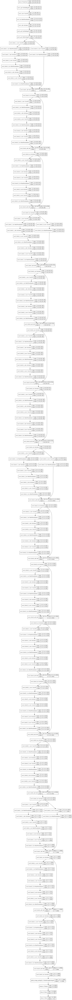

In [0]:
keras.utils.plot_model(model_resNet,show_shapes=True)

In [0]:
model_resNet.summary()

Model: "functional_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_20 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_20[0][0]                   
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
_______________________________________________________________________________________

####c. Tamaño de las imágenes de entrada.

In [0]:
# Establecimos usar estas medidas 224x224x3
image_dimension = (224,224,3)
print(image_dimension)

(224, 224, 3)


####d. Total de pesos del modelo propuesto y tamaño en MB del mismo.

In [0]:
model_resNet.save_weights("resNet.model") # 91.59 MB

In [0]:
#Pesos del Modelo
model_weights = model_resNet.get_weights()
print(model_weights)

[array([[[[ 2.82526277e-02, -1.18737184e-02,  1.51488732e-03, ...,
          -1.07003953e-02, -5.27982824e-02, -1.36667420e-03],
         [ 5.86827798e-03,  5.04415408e-02,  3.46324709e-03, ...,
           1.01423981e-02,  1.39493728e-02,  1.67549420e-02],
         [-2.44090753e-03, -4.86173332e-02,  2.69966386e-03, ...,
          -3.44439060e-04,  3.48098315e-02,  6.28910400e-03]],

        [[ 1.81872323e-02, -7.20698107e-03,  4.80302610e-03, ...,
          -7.43396254e-03, -8.56800564e-03,  1.16849300e-02],
         [ 1.87554304e-02,  5.12730293e-02,  4.50406177e-03, ...,
           1.39413681e-02,  1.26296384e-02, -1.73004344e-02],
         [ 1.90453827e-02, -3.87909152e-02,  4.25842637e-03, ...,
           2.75742816e-04, -1.27962548e-02, -8.35626759e-03]],

        [[ 1.58849321e-02, -1.06073255e-02,  1.30999666e-02, ...,
          -2.26797583e-03, -3.98984266e-04,  3.39989027e-04],
         [ 3.61421369e-02,  5.02430499e-02,  1.22699486e-02, ...,
           1.19910473e-02,  2.028

####e. Tiempo de entrenamiento

In [0]:
import time
#Entrenar modelo e imprimir tiempos
t = time.process_time()
history = model_resNet.fit(train_ds,
                    epochs=initial_epochs,
                    validation_data=val_ds)
print("elapsed_time = ", time.process_time() - t)

Epoch 1/10
22/22 [==============================] - 139s 6s/step - loss: 0.7299 - accuracy: 0.5462 - val_loss: 0.6196 - val_accuracy: 0.8000
Epoch 2/10
22/22 [==============================] - 138s 6s/step - loss: 0.6187 - accuracy: 0.6871 - val_loss: 0.5517 - val_accuracy: 0.8743
Epoch 3/10
22/22 [==============================] - 138s 6s/step - loss: 0.5515 - accuracy: 0.7681 - val_loss: 0.4686 - val_accuracy: 0.9029
Epoch 4/10
22/22 [==============================] - 138s 6s/step - loss: 0.4787 - accuracy: 0.7852 - val_loss: 0.3726 - val_accuracy: 0.9143
Epoch 5/10
22/22 [==============================] - 138s 6s/step - loss: 0.4122 - accuracy: 0.8535 - val_loss: 0.2858 - val_accuracy: 0.9200
Epoch 6/10
22/22 [==============================] - 138s 6s/step - loss: 0.3416 - accuracy: 0.8649 - val_loss: 0.2250 - val_accuracy: 0.9371
Epoch 7/10
22/22 [==============================] - 139s 6s/step - loss: 0.2920 - accuracy: 0.8933 - val_loss: 0.1878 - val_accuracy: 0.9429
Epoch 8/10
22

####f. Resumen numérico: precision, recall, f 1-score y matriz de confusión.

In [0]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
score = model_resNet.evaluate(val_x, val_y, verbose=0, batch_size=batch_size)
print(f'Test loss: {score[0]} / Test accuracy: {score[1]}')

print("Predictions:")
predictions_test = model_resNet.predict(val_x, batch_size=batch_size)
print(predictions_test[0])

print(classification_report(val_y.argmax(axis=1),
      predictions_test.argmax(axis=1),target_names=["Covid","Normal"]))

Test loss: 0.13290441036224365 / Test accuracy: 0.9485714435577393
Predictions:
[0.88449466 0.0265502 ]
              precision    recall  f1-score   support

       Covid       0.99      0.90      0.94        80
      Normal       0.92      0.99      0.95        95

    accuracy                           0.95       175
   macro avg       0.95      0.94      0.95       175
weighted avg       0.95      0.95      0.95       175



In [0]:
confusion_matrix(val_y.argmax(axis=1), predictions_test.argmax(axis=1))

array([[72,  8],
       [ 1, 94]])

####g. Gráficas de la precisión (accuracy) y del error de los conjuntos de entrenamiento y prueba.

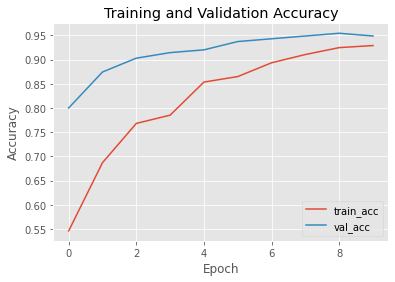

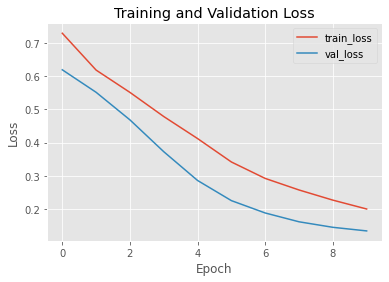

In [0]:
plotAccuLost(history, n_epochs)

###C. Xception


In [0]:
#Xception Model
from tensorflow import keras

#Variables del modelo
n_epochs = 10

#Definicióón de la base Xception
base_model = tf.keras.applications.Xception(input_shape=inputs,include_top=False, weights='imagenet')
base_model.trainable = False

x = base_model.output
# Adicionando capas de classificion
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(100, activation='relu')(x)
num_classes = 2
predictions = tf.keras.layers.Dense(num_classes, activation='softmax')(x)

xception_model = tf.keras.Sequential()

xception_model = tf.keras.models.Model(inputs=base_model.input, outputs=predictions)
xception_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

####a. Resumen de las características principales del modelo: Partición utilizada, método de optimización, tamaño de batches, tasa de aprendizaje, etc.


**Características principales del Modelo:**
* Para este modelo corremos 10 épocas.
* Este modelo emplea el optimizador Adam con un learning rate de 0.01
* El batch size es de 32
* Clasificador de activación "softmax"
* Para la perdida usamos categorica cruzada binaria


####b. Resumen de la arquitectura propuesta.

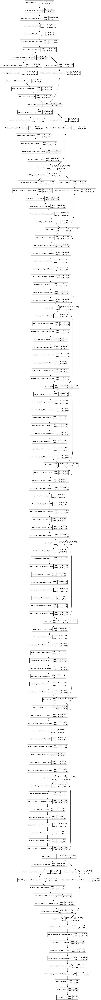

In [0]:
#Resumen de la arquitectura
keras.utils.plot_model(xception_model, show_shapes=True)

In [0]:
#Capas del modelo Xception
xception_model.summary()

Model: "functional_16"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_26 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 111, 111, 32) 864         input_26[0][0]                   
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 111, 111, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 111, 111, 32) 0           block1_conv1_bn[0][0]            
______________________________________________________________________________________

####c. Tamaño de las imágenes de entrada.

**El tamaño de las imágenes es de (224,224,3) es decir son imágenes de 224 x 224 pixeles, y son imágenes a color RGB por eso 3 capas, una por cada color.**

####d. Total de pesos del modelo propuesto y tamaño en MB del mismo.

In [0]:
#Pesos del Modelo Xception
model_weights = xception_model.get_weights()
print(model_weights)

[array([[[[ 4.01871502e-01,  6.77069500e-02, -9.92160812e-02,
          -2.40881741e-01,  4.94409263e-01, -1.35092044e+00,
          -7.53455386e-02, -1.15802072e-01,  2.54089713e-01,
           4.12381589e-01, -2.02945337e-01, -5.65736771e-01,
           1.53094187e-01, -5.43646663e-02,  9.78396833e-02,
          -2.72699267e-01, -9.39905122e-02,  3.93782228e-01,
           3.33525687e-01,  2.95914084e-01, -3.14331800e-02,
          -1.99261308e-01,  1.59772888e-01, -3.25841278e-01,
          -1.50597319e-01, -7.27500841e-02,  1.80662051e-02,
           3.05232316e-01,  8.96351188e-02,  2.89342284e-01,
          -2.50950217e-01, -7.65512884e-01],
         [ 4.84812856e-02,  4.23621461e-02,  4.00314759e-03,
          -3.78118306e-02, -5.52299500e-01,  7.35755444e-01,
          -3.38940531e-01, -1.09324297e-02, -8.63540769e-02,
          -7.23446161e-02, -5.50143421e-01, -5.00105917e-01,
           2.29335129e-01,  2.17402652e-01, -1.51911721e-01,
          -3.03186446e-01,  1.59955341e

In [0]:
#Descargar el modelo y obtener su tamaño
model.save("xception.hdf5")

**Tamaño del Modelo: 82.32MB**

####e. Tiempo de entrenamiento

In [0]:
#Entrenar modelo e imprimir tiempos
n_epochs = 10
t = time.process_time()
H = xception_model.fit(train_ds, epochs=n_epochs, validation_data=validation_ds)
print("elapsed_time = ", time.process_time() - t)

Epoch 1/10
22/22 [==============================] - 193s 9s/step - loss: 3.9274 - accuracy: 0.6942 - val_loss: 1.3463 - val_accuracy: 0.8914
Epoch 2/10
22/22 [==============================] - 193s 9s/step - loss: 2.7764 - accuracy: 0.8009 - val_loss: 0.9131 - val_accuracy: 0.9371
Epoch 3/10
22/22 [==============================] - 193s 9s/step - loss: 1.9109 - accuracy: 0.8521 - val_loss: 0.9901 - val_accuracy: 0.9200
Epoch 4/10
22/22 [==============================] - 194s 9s/step - loss: 1.8756 - accuracy: 0.8592 - val_loss: 0.3876 - val_accuracy: 0.9714
Epoch 5/10
22/22 [==============================] - 194s 9s/step - loss: 1.6839 - accuracy: 0.8734 - val_loss: 0.4901 - val_accuracy: 0.9600
Epoch 6/10
22/22 [==============================] - 194s 9s/step - loss: 1.6505 - accuracy: 0.8791 - val_loss: 0.4872 - val_accuracy: 0.9600
Epoch 7/10
22/22 [==============================] - 195s 9s/step - loss: 1.7209 - accuracy: 0.8734 - val_loss: 1.8050 - val_accuracy: 0.8571
Epoch 8/10
22

**Tiempo total de entrenamiento 1 hora 3 minutos 29 segundos**

####f. Resumen numérico: precision, recall, f 1-score y matriz de confusión.

In [0]:
#Resumen númerico de precision modelo EfficientNet
from sklearn.metrics import classification_report
label_names = ["covid","normal"]
predictions_test = xception_model.predict(images, batch_size=32)
print(classification_report(labels.argmax(axis=1),
      predictions_test.argmax(axis=1), target_names=label_names))

              precision    recall  f1-score   support

       covid       1.00      0.95      0.97        80
      normal       0.96      1.00      0.98        95

    accuracy                           0.98       175
   macro avg       0.98      0.97      0.98       175
weighted avg       0.98      0.98      0.98       175



In [0]:
from sklearn.metrics import confusion_matrix

confusion_matrix(labels.argmax(axis=1), predictions_test.argmax(axis=1))


array([[76,  4],
       [ 0, 95]])

####g. Gráficas de la precisión (accuracy) y del error de los conjuntos de entrenamiento y prueba.

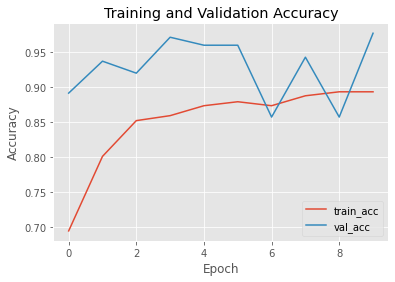

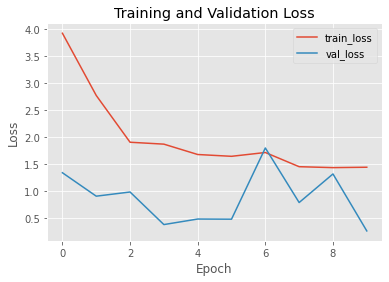

In [0]:
#Graficar precicisión del modelo Xception

plotAccuLost(H, n_epochs)

In [0]:
# Evaluate the model on the test data using `evaluate`
print('\n# Evaluate on test data')
loss, accuracy = xception_model.evaluate(validation_ds, batch_size=128, verbose=0)

print('test loss:', loss)
print('test acc:', accuracy)



# Evaluate on test data
test loss: 0.2702023386955261
test acc: 0.977142870426178


###D. Inception/GoogleLeNet

En esta arquitectura logramos 97% de efectividad con los optimizadores Adam, Nadam y RMSprop, sin embargo nos decidimos por Adam ya que fue lígeramente más rápido y con una líegera mejor perdida que NADAM, sin embargo ambos pordrían ser usados con un desempeño casi igual.

#### Final

##### a. Resumen de las características principales del modelo: Partición utilizada, método de optimización, tamaño de batches, tasa de aprendizaje, etc.


**InceptionV3**
* Batch Size: 64
* Optimimizador: Adam
* Función de Loss:  Categorical Cross-Entropy
* Weights: imagenet
* Pooling: GlobalAveragePooling2D
* Dropout(0.001)
* Layers 100 activation = selu
* 2 classification classes activation: softmax

In [0]:
#Inception-V3
# https://keras.io/api/applications/inceptionv3/
from tensorflow import keras
#Variables del modelo
inceptionV3_n_epochs = 10
inceptionV3_optimizer = keras.optimizers.Adam()
inceptionV3_loss = keras.losses.BinaryCrossentropy()

#Definicióón de la base
base_model = tf.keras.applications.InceptionV3(include_top=False, weights='imagenet', input_shape=(224,224,3))
base_model.trainable = False
x = base_model.output

# Adicionando capas de classificion
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(100, activation='sigmoid')(x)
num_classes = 2
predictions = tf.keras.layers.Dense(num_classes, activation='softmax')(x)

inceptionV3_model = tf.keras.Sequential()

inceptionV3_model = tf.keras.models.Model(inputs=base_model.input, outputs=predictions)
#Compile
inceptionV3_model.compile(optimizer=inceptionV3_optimizer, loss=inceptionV3_loss,  metrics=['accuracy'])

In [0]:
#Entrenar modelo e imprimir tiempos
inceptionV3_t = time.process_time()
inceptionV3_H = inceptionV3_model.fit(train_ds, epochs=inceptionV3_n_epochs, validation_data=test_ds)
print("Tiempo Total = ", time.process_time() - inceptionV3_t)

Epoch 1/10
11/11 [==============================] - 7s 678ms/step - loss: 0.6201 - accuracy: 0.6785 - val_loss: 0.4616 - val_accuracy: 0.8057
Epoch 2/10
11/11 [==============================] - 6s 583ms/step - loss: 0.4500 - accuracy: 0.8023 - val_loss: 0.2998 - val_accuracy: 0.9371
Epoch 3/10
11/11 [==============================] - 7s 592ms/step - loss: 0.3785 - accuracy: 0.8620 - val_loss: 0.2362 - val_accuracy: 0.9200
Epoch 4/10
11/11 [==============================] - 6s 582ms/step - loss: 0.3081 - accuracy: 0.9018 - val_loss: 0.1934 - val_accuracy: 0.9371
Epoch 5/10
11/11 [==============================] - 6s 576ms/step - loss: 0.2822 - accuracy: 0.9004 - val_loss: 0.1644 - val_accuracy: 0.9543
Epoch 6/10
11/11 [==============================] - 7s 595ms/step - loss: 0.2490 - accuracy: 0.9161 - val_loss: 0.1389 - val_accuracy: 0.9600
Epoch 7/10
11/11 [==============================] - 7s 593ms/step - loss: 0.2246 - accuracy: 0.9232 - val_loss: 0.1265 - val_accuracy: 0.9657
Epoch 

##### b. Resumen de la arquitectura propuesta.

###### InceptionV3 model (graphic)

In [0]:
keras.utils.plot_model(inceptionV3_model, show_shapes=True)

###### InceptionV3 model summary



In [0]:
inceptionV3_model.summary()

Model: "functional_29"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_16 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_1410 (Conv2D)            (None, 111, 111, 32) 864         input_16[0][0]                   
__________________________________________________________________________________________________
batch_normalization_1410 (Batch (None, 111, 111, 32) 96          conv2d_1410[0][0]                
__________________________________________________________________________________________________
activation_1410 (Activation)    (None, 111, 111, 32) 0           batch_normalization_1410[0][0]   
______________________________________________________________________________________

##### c. Tamaño de las imágenes de entrada.

****Decidimos un tamaño consistente de entrada 234x234x3****

##### d. Total de pesos del modelo propuesto y tamaño en MB del mismo.

###### InceptionV3 model weight in MB

In [0]:
inceptionV3_model.save("inceptionV3_xfer_Final.hdf5")

 **86.35 Mb**

###### Inception V3 model weights

In [0]:
inceptionV3_model_weights = inception_model.get_weights()
print(inceptionV3_model_weights)

[array([[[[-4.59105551e-01, -4.14526574e-02, -3.62577499e-03,
          -9.87672508e-02, -3.37070860e-02,  4.79929037e-02,
           2.32542142e-01,  3.23927671e-01,  5.90160079e-02,
           9.47738215e-02,  4.24996056e-02,  1.26620471e-01,
           1.33215979e-01,  1.22741833e-01, -7.92686343e-02,
           2.08227970e-02, -1.99647829e-01, -3.02687973e-01,
          -2.10659921e-01, -3.52898419e-01, -5.58023095e-01,
           3.20223093e-01,  4.53596050e-03, -3.09266411e-02,
          -6.86957911e-02,  2.00968519e-01,  1.14542745e-01,
           2.40372881e-01,  1.52943470e-02,  5.96231259e-02,
          -5.85714653e-02,  8.78173351e-01],
         [ 3.16376328e-01, -4.78494260e-03, -6.84681814e-03,
           7.44503662e-02, -1.97458476e-01,  5.20143658e-02,
          -1.24460436e-01,  3.36123914e-01,  3.01678218e-02,
          -1.26477107e-01, -1.05597451e-01, -5.31241074e-02,
          -2.43102223e-01,  1.66047230e-01, -1.03186309e-01,
          -6.55613691e-02,  2.60930099e

##### e. Tiempo de entrenamiento

**Tiempo Total =  163.78** 
vs 6646.050869654999 sin GPU

##### f. Resumen numérico: precision, recall, f 1-score y matriz de confusión.

###### Preparamos los datos para obtener los valores con sklearn

In [0]:
###### Separamos las Imágenes y los labels del set de pruebas
r = []
i = []
#for each batch
for batch in test_ds:
  #for each label
  for label in batch[1]:
    toInt = label.numpy().astype(int)
    r.append(toInt)
  #for each image
  for image in batch[0]:
    toUint = image.numpy().astype("uint8")
    i.append(toUint)

labels = np.array(r)
images = np.array(i)
print(labels.shape)
print(images.shape)

(175, 2)
(175, 224, 224, 3)


###### Resumen númerico y de precisión del modelo


In [0]:
###### Resumen númerico de precision del modelo
from sklearn.metrics import classification_report
label_names = ["Covid","Normal"]
predictions_test = inceptionV3_model.predict(images, batch_size=64)
print(classification_report(labels.argmax(axis=1),
      predictions_test.argmax(axis=1), target_names=label_names))

              precision    recall  f1-score   support

       Covid       0.96      0.96      0.96        80
      Normal       0.97      0.97      0.97        95

    accuracy                           0.97       175
   macro avg       0.97      0.97      0.97       175
weighted avg       0.97      0.97      0.97       175



###### Matriz de Confusión

In [0]:
from sklearn.metrics import confusion_matrix
confusion_matrix(labels.argmax(axis=1), predictions_test.argmax(axis=1))

array([[77,  3],
       [ 3, 92]])

##### g. Gráficas de la precisión (accuracy) y del error de los conjuntos de entrenamiento y prueba.

###### Gráficas de desempeño

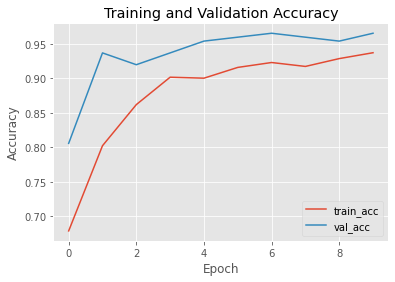

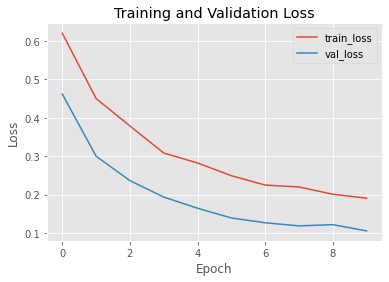

In [0]:
plotAccuLost(inceptionV3_H, inceptionV3_n_epochs)

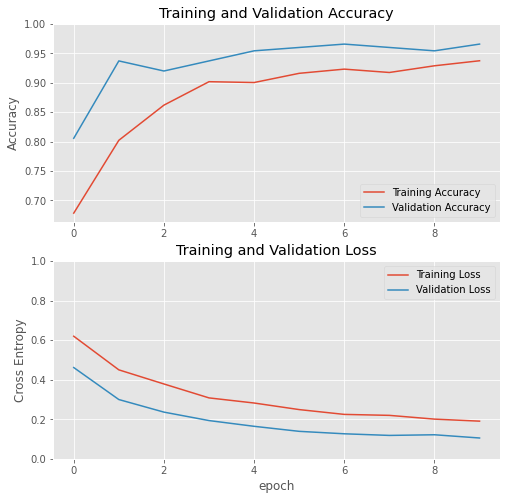

In [0]:
history = inceptionV3_H 

acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

###E. Inception-ResNet

Para este modelo se compararon las funciones de activación relu, tanh, sigmoid, exponential, elu, selu, softmax, softplus, soft-sign. Así como combinaciones de filtros de pooling (Max y Avg) y funciones de perdidad (softplus y poisson). En general en todas el desempeño fue pobre, siendo la arquitectura aquí mostrada la que obtuvo mejor f1-score y accuracy.

#### Final

**Inception-ResNetV2**
* Batch Size: 64
* Optimimizador: SGD
* Función de Loss:  Categorical Cross-Entropy
* Weights imagenet
* GlobalAveragePooling2D
* Dropout(0.001)
* Layers 100 activation = seli
* 2 classification classes activation: softmax

In [0]:
#Inception Model #Corrida 4
from tensorflow import keras

#Variables del modelo
n_epochs = 10
inputs=(224,224,3)

#Definicióón de la base Inception
base_model = tf.keras.applications.InceptionResNetV2(input_shape=inputs,include_top=False, weights='imagenet')
base_model.trainable = False

x = base_model.output
# Adicionando capas de classificion
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.Dropout(0.001)(x)
x = tf.keras.layers.Dense(100, activation='selu')(x)
num_classes = 2
predictions = tf.keras.layers.Dense(num_classes, activation='softmax')(x)
opt = keras.optimizers.SGD()
inception_model = tf.keras.Sequential()
loss_xception = tf.keras.losses.CategoricalCrossentropy

inception_model = tf.keras.models.Model(inputs=base_model.input, outputs=predictions)
inception_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [0]:
t = time.process_time()
H = inception_model.fit(train_ds, epochs=n_epochs, validation_data=validation_ds)
print("elapsed_time = ", time.process_time() - t)

Epoch 1/10
22/22 [==============================] - 16s 734ms/step - loss: 1.0073 - accuracy: 0.8108 - val_loss: 0.5921 - val_accuracy: 0.8629
Epoch 2/10
22/22 [==============================] - 13s 604ms/step - loss: 0.2945 - accuracy: 0.8990 - val_loss: 0.3948 - val_accuracy: 0.8971
Epoch 3/10
22/22 [==============================] - 13s 606ms/step - loss: 0.2455 - accuracy: 0.9189 - val_loss: 0.5144 - val_accuracy: 0.8514
Epoch 4/10
22/22 [==============================] - 13s 608ms/step - loss: 0.2514 - accuracy: 0.9090 - val_loss: 1.0555 - val_accuracy: 0.8000
Epoch 5/10
22/22 [==============================] - 13s 606ms/step - loss: 0.2337 - accuracy: 0.9232 - val_loss: 1.0002 - val_accuracy: 0.7886
Epoch 6/10
22/22 [==============================] - 13s 606ms/step - loss: 0.2740 - accuracy: 0.9175 - val_loss: 0.3728 - val_accuracy: 0.8857
Epoch 7/10
22/22 [==============================] - 13s 612ms/step - loss: 0.2150 - accuracy: 0.9303 - val_loss: 0.2415 - val_accuracy: 0.9257

##### b. Resumen de la arquitectura propuesta.

###### Inception-ResNet model (graphic)

In [0]:
#Resumen de la arquitectura

keras.utils.plot_model(inception_model, show_shapes=True)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.515237 to fit
tcmalloc: large alloc 1154187264 bytes == 0x55eb841ba000 @  0x7fe1272f4001 0x7fe12358b1fa 0x7fe12358b2ad 0x7fe1247166df 0x7fe124c0d261 0x7fe12708a468 0x7fe12708cd53 0x55eb82095092 0x7fe126a3fb97 0x55eb8209512a



###### Inception-ResNet model summary



In [0]:
#Arquitectura del modelo propuesto
inception_model.summary()

Model: "functional_9"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_812 (Conv2D)             (None, 111, 111, 32) 864         input_5[0][0]                    
__________________________________________________________________________________________________
batch_normalization_812 (BatchN (None, 111, 111, 32) 96          conv2d_812[0][0]                 
__________________________________________________________________________________________________
activation_812 (Activation)     (None, 111, 111, 32) 0           batch_normalization_812[0][0]    
_______________________________________________________________________________________

##### c. Tamaño de las imágenes de entrada.

**Decidimos un tamaño consistente de entrada 234x234x3**

##### d. Total de pesos del modelo propuesto y tamaño en MB del mismo.

###### Inception-ResNet model weight in MB

In [0]:
inception_model.save("incRes_xfer-Inc-Res-Final.hdf5")

 **209.84 Mb**

###### Inception-ResNet model weights

In [0]:
incRes_model_weights = inception_model.get_weights()
print(incRes_model_weights)

[array([[[[-1.63356900e-01, -6.17088936e-03,  1.31041095e-01,
           3.69789302e-02, -1.25390440e-01,  5.64914942e-02,
          -3.34196649e-02,  3.85071449e-02, -1.42315730e-01,
          -4.65757668e-01,  2.88656913e-02, -2.29952231e-01,
           2.93689221e-01,  3.70038033e-01,  1.04863588e-02,
          -5.95548749e-02,  4.02644416e-03, -6.59151852e-01,
           4.78085995e-01,  2.54727662e-01, -5.34945633e-03,
           4.83594924e-01, -2.09189281e-01,  5.81100464e-01,
          -1.35197695e-02,  4.32890505e-01, -4.08778906e-01,
           1.29318982e-01,  2.92476296e-01,  1.29870713e-01,
          -7.00813308e-02, -1.88857064e-01],
         [ 1.76385362e-02,  1.80546902e-02, -6.06614277e-02,
           1.45480633e-01, -6.07440658e-02,  2.83849817e-02,
          -4.47433330e-02, -4.81597036e-02,  4.65660952e-02,
          -6.00845039e-01, -4.37628180e-02,  5.42540371e-01,
           4.20721650e-01,  4.56823856e-01, -4.83046435e-02,
           1.23057008e-01, -3.67723137e

##### e. Tiempo de entrenamiento

**Tiempo Total =  163.78303428499999** con GPU 
(vs Tiempo Total (sesgs) =  4085.7238967690005)

##### f. Resumen numérico: precision, recall, f 1-score y matriz de confusión.

###### Preparamos los datos para obtener los valores con sklearn

In [0]:
###### Separamos las Imágenes y los labels del set de pruebas
r = []
i = []
#for each batch
for batch in test_ds:
  #for each label
  for label in batch[1]:
    toInt = label.numpy().astype(int)
    r.append(toInt)
  #for each image
  for image in batch[0]:
    toUint = image.numpy().astype("uint8")
    i.append(toUint)

labels = np.array(r)
images = np.array(i)
print(labels.shape)
print(images.shape)

(175, 2)
(175, 224, 224, 3)


###### Resumen númerico de precisión modelo


In [0]:
#Resumen númerico de precision modelo Inception
from sklearn.metrics import classification_report
label_names = ["covid","normal"]
predictions_test = inception_model.predict(images, batch_size=32)
print(classification_report(labels.argmax(axis=1),
      predictions_test.argmax(axis=1), target_names=label_names))

              precision    recall  f1-score   support

       covid       0.98      0.94      0.96        94
      normal       0.93      0.98      0.95        81

    accuracy                           0.95       175
   macro avg       0.95      0.96      0.95       175
weighted avg       0.96      0.95      0.95       175



###### Matriz de Confusión

In [0]:
from sklearn.metrics import confusion_matrix

confusion_matrix(labels.argmax(axis=1), predictions_test.argmax(axis=1))


array([[88,  6],
       [ 2, 79]])

##### g. Gráficas de la precisión (accuracy) y del error de los conjuntos de entrenamiento y prueba.

###### Gráficas de desempeño

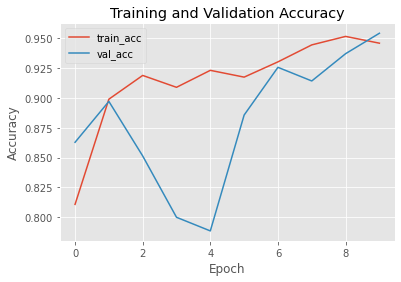

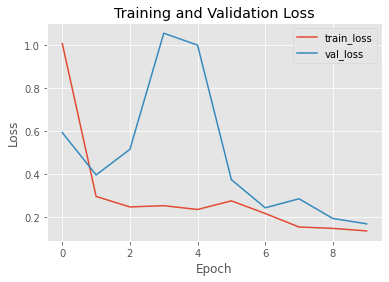

In [0]:
#Graficar precicisión del modelo Inception
#Corrida 4

plotAccuLost(H, n_epochs)

###F. MobileNet

####a. Resumen de las características principales del modelo: Partición utilizada, método de optimización, tamaño de batches, tasa de aprendizaje, etc.


In [0]:
import matplotlib
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing import image_dataset_from_directory

#Ubicación de las imágenes
mypath = '/content/xray'
print(mypath)

##Variables de imágen
image_size = (224, 224) #image size
batch_size = 32 #baches size
n_epochs = 10 # # epochs

train_ds = tf.keras.preprocessing.image_dataset_from_directory(
    mypath,
    labels="inferred",
    class_names=['covid', 'normal'],
    color_mode="rgb",
    label_mode= "categorical",
    seed=1337,
    validation_split = 0.2,
    subset = "training",
    image_size=image_size,
    batch_size=batch_size,
)

val_ds = tf.keras.preprocessing.image_dataset_from_directory(
    mypath,
    labels="inferred",
    class_names=['covid', 'normal'],
    color_mode="rgb",
    label_mode= "categorical",
    seed=1337,
    validation_split = 0.2,
    subset = "validation",
    image_size=image_size,
    batch_size=batch_size,
)

/content/xray
Found 878 files belonging to 2 classes.
Using 703 files for training.
Found 878 files belonging to 2 classes.
Using 175 files for validation.


In [0]:
#Plot function to be reused to plot model's Accuracy and Loss
def plotAccuLost(model_H, epochs):
  plt.style.use("ggplot")
  #First Plot Training and Validation Accuracy
  plt.figure()
  plt.plot(np.arange(0,epochs),model_H.history["accuracy"],label="train_acc")
  plt.plot(np.arange(0,epochs),model_H.history["val_accuracy"],label="val_acc")
  plt.title("Training and Validation Accuracy")
  plt.xlabel("Epoch")
  plt.ylabel("Accuracy")
  plt.legend()
  #Second Plot Training and Validation Lioss
  plt.figure()
  plt.plot(np.arange(0,epochs),model_H.history["loss"],label="train_loss") 
  plt.plot(np.arange(0,epochs),model_H.history["val_loss"],label="val_loss")
  plt.title("Training and Validation Loss")
  plt.xlabel("Epoch")
  plt.ylabel("Loss")
  plt.legend()
  #Print Plot
  plt.show()

In [0]:
#Separamos las Imágenes y labels del set de val
l = []
i = []
#for each bach
for image,label in val_ds.unbatch():
  l.append(label.numpy().astype(int))
  i.append(image.numpy().astype(int))

val_y = np.array(l)
val_x = np.array(i)
print(val_y.shape)
print(val_x.shape)

(175, 2)
(175, 224, 224, 3)


In [0]:
#Separamos las Imágenes y labels del set de train
l = []
i = []
#for each bach
for image,label in train_ds.unbatch():
  l.append(label.numpy().astype(int))
  i.append(image.numpy().astype(int))

train_y = np.array(l)
train_x = np.array(i)
print(train_y.shape)
print(train_x.shape)

(703, 2)
(703, 224, 224, 3)


In [0]:
#Creamos el modelo base MobileNet
base_model = tf.keras.applications.MobileNet(input_shape=image_dimension,
                                               include_top=False, weights='imagenet')
base_model.trainable = False

In [0]:
feature_batch = base_model(train_x)
print(feature_batch.shape)

(703, 7, 7, 1024)


In [0]:
base_model.summary()

Model: "mobilenet_1.00_224"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_12 (InputLayer)        [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv1_pad (ZeroPadding2D)    (None, 225, 225, 3)       0         
_________________________________________________________________
conv1 (Conv2D)               (None, 112, 112, 32)      864       
_________________________________________________________________
conv1_bn (BatchNormalization (None, 112, 112, 32)      128       
_________________________________________________________________
conv1_relu (ReLU)            (None, 112, 112, 32)      0         
_________________________________________________________________
conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)      288       
_________________________________________________________________
conv_dw_1_bn (BatchNormaliza (None, 112, 112, 32

In [0]:
x = base_model.output
# Adicionando layers de classificion
x = tf.keras.layers.GlobalAveragePooling2D()(x)#name='avg_pool'
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.Dense(1280, activation='relu')(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.BatchNormalization()(x)
num_classes = 2
predictions = tf.keras.layers.Dense(num_classes, activation='softmax')(x)
model_mobileNet = tf.keras.Sequential()
model_mobileNet = tf.keras.models.Model(inputs=base_model.input, outputs=predictions)

In [0]:
# Se seleccionaron estos optimizadores y capas porque consideramos son con los que optenemos mejores resultados
base_learning_rate = 0.0001
opt =tf.keras.optimizers.SGD(lr=base_learning_rate,decay=base_learning_rate / 10, momentum=0.9, nesterov=True)
model_mobileNet.compile(optimizer= opt,
              loss=tf.keras.losses.binary_crossentropy,
              metrics=['accuracy'])

In [0]:
len(model_mobileNet.trainable_variables)

4

####b. Resumen de la arquitectura propuesta.

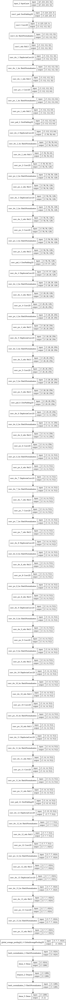

In [0]:
keras.utils.plot_model(model_mobileNet,show_shapes=True)

In [0]:
model_mobileNet.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv1_pad (ZeroPadding2D)    (None, 225, 225, 3)       0         
_________________________________________________________________
conv1 (Conv2D)               (None, 112, 112, 32)      864       
_________________________________________________________________
conv1_bn (BatchNormalization (None, 112, 112, 32)      128       
_________________________________________________________________
conv1_relu (ReLU)            (None, 112, 112, 32)      0         
_________________________________________________________________
conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)      288       
_________________________________________________________________
conv_dw_1_bn (BatchNormaliza (None, 112, 112, 32)     

####c. Tamaño de las imágenes de entrada.

In [0]:
image_dimension = (224,224,3)
# Establecimos usar estas medidas 224x224x3
print(image_dimension)

(224, 224, 3)


####d. Total de pesos del modelo propuesto y tamaño en MB del mismo.

In [0]:
model_mobileNet.save_weights('mobileNet.model') #13.12 Mb

In [0]:
#Pesos del Modelo
model_weights = model_mobileNet.get_weights()
print(model_weights)

[array([[[[ 8.87084053e-14,  3.11129272e-01,  1.19772255e-02,
           1.65614850e-13,  1.67507152e-14,  2.31184348e-01,
          -2.32737631e-01, -2.96911478e-01, -4.32953903e-15,
           8.21083635e-02,  3.79058927e-01,  9.35078702e-14,
           1.45881534e-01,  1.58076912e-01, -1.66753982e-03,
           4.56319394e-05, -5.14434686e-13, -1.85627863e-01,
           4.04302508e-01, -2.56781399e-01,  1.27436947e-13,
           8.86099631e-15, -6.08684048e-02,  2.80227751e-01,
           1.13050954e-03,  2.00989982e-03,  3.01095426e-01,
          -1.71066225e-01, -5.65458477e-01,  2.62688458e-01,
          -4.01542217e-01, -2.50179484e-03],
         [ 1.05321493e-13, -3.48603338e-01,  3.99522372e-02,
           1.44252747e-13,  5.91760866e-14,  1.67545795e-01,
          -1.13974318e-01,  9.64645147e-02,  8.52340540e-15,
          -1.87848985e-01,  3.75256538e-01,  1.19941383e-13,
           1.45519465e-01,  1.86711788e-01,  1.53669920e-02,
           4.60369374e-05, -5.77872602e

####e. Tiempo de entrenamiento

In [0]:
import time
#Entrenar modelo e imprimir tiempos
t = time.process_time()
history = model_mobileNet.fit(train_ds,
                    epochs=n_epochs,
                    validation_data=val_ds)
print("elapsed_time = ", time.process_time() - t)

Epoch 1/10
22/22 [==============================] - 11s 509ms/step - loss: 0.6938 - accuracy: 0.6316 - val_loss: 0.3988 - val_accuracy: 0.8743
Epoch 2/10
22/22 [==============================] - 11s 491ms/step - loss: 0.4103 - accuracy: 0.7980 - val_loss: 0.3181 - val_accuracy: 0.8914
Epoch 3/10
22/22 [==============================] - 11s 487ms/step - loss: 0.3257 - accuracy: 0.8620 - val_loss: 0.2749 - val_accuracy: 0.8857
Epoch 4/10
22/22 [==============================] - 11s 486ms/step - loss: 0.3128 - accuracy: 0.8805 - val_loss: 0.2393 - val_accuracy: 0.9029
Epoch 5/10
22/22 [==============================] - 11s 491ms/step - loss: 0.2383 - accuracy: 0.9004 - val_loss: 0.2098 - val_accuracy: 0.9086
Epoch 6/10
22/22 [==============================] - 11s 487ms/step - loss: 0.2227 - accuracy: 0.9061 - val_loss: 0.1865 - val_accuracy: 0.9086
Epoch 7/10
22/22 [==============================] - 11s 489ms/step - loss: 0.2373 - accuracy: 0.9090 - val_loss: 0.1658 - val_accuracy: 0.9200

####f. Resumen numérico: precision, recall, f 1-score y matriz de confusión.

In [0]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
score = model_mobileNet.evaluate(val_x, val_y, verbose=0, batch_size=batch_size)
print(f'Test loss: {score[0]} / Test accuracy: {score[1]}')

print("Predictions:")
predictions_test = model_mobileNet.predict(val_x, batch_size=batch_size)
print(predictions_test[0])

print(classification_report(val_y.argmax(axis=1),
      predictions_test.argmax(axis=1),target_names=["Covid","Normal"]))

Test loss: 0.12470465153455734 / Test accuracy: 0.954285740852356
Predictions:
[0.01095484 0.98904514]
              precision    recall  f1-score   support

       Covid       0.96      0.94      0.95        80
      Normal       0.95      0.97      0.96        95

    accuracy                           0.95       175
   macro avg       0.95      0.95      0.95       175
weighted avg       0.95      0.95      0.95       175



In [0]:
confusion_matrix(val_y.argmax(axis=1), predictions_test.argmax(axis=1))

array([[75,  5],
       [ 3, 92]])

####g. Gráficas de la precisión (accuracy) y del error de los conjuntos de entrenamiento y prueba.

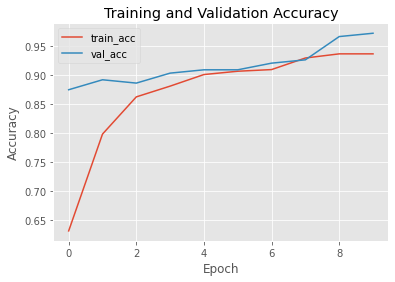

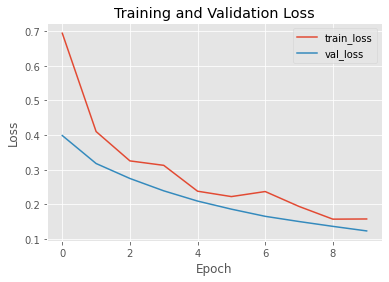

In [0]:
plotAccuLost(history, n_epochs)

###G. DenseNet

In [0]:
#Modelo DenseNet
from tensorflow import keras
#Variables del modelo
n_epochs = 9
densenet_opt = keras.optimizers.SGD()
input_shape=(224, 224, 3)
base_learning_rate = 0.0001
opt =tf.keras.optimizers.SGD(lr=base_learning_rate,decay=base_learning_rate / 10, momentum=0.9, nesterov=True)

# Creación de la base del model DenseNet
base_model = tf.keras.applications.DenseNet121(input_shape=input_shape,include_top=False, weights='imagenet')
base_model.trainable = False

x = base_model.output
# Adicionando layers de classificion
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(100, activation='relu')(x)
num_classes = 2
predictions = tf.keras.layers.Dense(num_classes, activation='softmax')(x)
densenet_model = tf.keras.Sequential()
densenet_model = tf.keras.models.Model(inputs=base_model.input, outputs=predictions)


densenet_model.compile(optimizer=densenet_opt, loss=tf.keras.losses.categorical_crossentropy,metrics=['accuracy'])

####a. Resumen de las características principales del modelo: Partición utilizada, método de optimización, tamaño de batches, tasa de aprendizaje, etc.


**Características principales del Modelo:**
* Para este modelo corremos 9 épocas.
* Este modelo emplea el optimizador SGD con un learning rate de 0.0001
* El batch size es de 32
* Clasificador de activación relu
* Para la perdida usamos Entropía Categórica Cruzada


####b. Resumen de la arquitectura propuesta.

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.687516 to fit



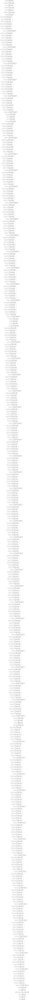

In [0]:
#Resumen de la arquitectura
keras.utils.plot_model(densenet_model, show_shapes=True)

In [0]:
densenet_model.summary()

Model: "densenet121"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
zero_padding2d_6 (ZeroPadding2D (None, 230, 230, 3)  0           input_4[0][0]                    
__________________________________________________________________________________________________
conv1/conv (Conv2D)             (None, 112, 112, 64) 9408        zero_padding2d_6[0][0]           
__________________________________________________________________________________________________
conv1/bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1/conv[0][0]                 
________________________________________________________________________________________

####c. Tamaño de las imágenes de entrada.

El tamaño de las imágenes es de (224,224,3) es decir son imágenes de 224 x 224 pixeles, y son imágenes a color RGB por eso 3 capas, una por cada color. 

####d. Total de pesos del modelo propuesto y tamaño en MB del mismo.

In [0]:
#Pesos del Modelo
model_weights = densenet_model.get_weights()
print(model_weights)

[array([[[[ 1.54006481e-02,  1.44004598e-02, -2.66531147e-02, ...,
          -4.23422009e-02, -6.55740872e-03, -1.69599056e-02],
         [-3.00565101e-02,  3.84811312e-03,  2.45270915e-02, ...,
           3.91229354e-02,  1.50535926e-02,  2.90576257e-02],
         [-2.14307383e-02,  2.74047256e-04, -3.66487354e-03, ...,
           3.35836746e-02,  1.63018890e-02, -4.20228280e-02]],

        [[ 1.40742175e-02,  2.43031047e-02,  7.36568496e-03, ...,
          -2.61359382e-02, -4.22641151e-02, -1.79122500e-02],
         [ 1.47630163e-02,  1.17690936e-02, -3.64558138e-02, ...,
          -4.96034697e-03, -1.70023162e-02, -6.37875497e-03],
         [ 3.95949148e-02, -3.27925608e-02,  3.11566852e-02, ...,
           2.77691297e-02, -2.34092735e-02, -3.92773375e-02]],

        [[-3.01706977e-02,  1.03585981e-02,  3.63111831e-02, ...,
          -3.76668051e-02, -4.98326123e-03,  2.53968947e-02],
         [ 1.20890252e-02, -2.92495806e-02, -2.84524560e-02, ...,
           2.03044824e-02,  1.514

Tamaño del Modelo: 27.94MB

####e. Tiempo de entrenamiento

In [0]:
#Entrenar modelo e imprimir tiempos Corrida 2
t = time.process_time()
H = densenet_model.fit(train_ds, epochs=9, validation_data=validation_ds)
print("elapsed_time = ", time.process_time() - t)

Epoch 1/9
22/22 [==============================] - 484s 22s/step - loss: 0.0519 - accuracy: 0.9858 - val_loss: 0.2339 - val_accuracy: 0.9543
Epoch 2/9
22/22 [==============================] - 484s 22s/step - loss: 0.0482 - accuracy: 0.9900 - val_loss: 0.1790 - val_accuracy: 0.9714
Epoch 3/9
22/22 [==============================] - 495s 22s/step - loss: 0.0477 - accuracy: 0.9858 - val_loss: 0.1759 - val_accuracy: 0.9429
Epoch 4/9
22/22 [==============================] - 484s 22s/step - loss: 0.0329 - accuracy: 0.9957 - val_loss: 0.3582 - val_accuracy: 0.7886
Epoch 5/9
22/22 [==============================] - 483s 22s/step - loss: 0.0414 - accuracy: 0.9900 - val_loss: 0.2003 - val_accuracy: 0.9371
Epoch 6/9
22/22 [==============================] - 489s 22s/step - loss: 0.0347 - accuracy: 0.9886 - val_loss: 0.1851 - val_accuracy: 0.8971
Epoch 7/9
22/22 [==============================] - 488s 22s/step - loss: 0.0418 - accuracy: 0.9872 - val_loss: 0.1029 - val_accuracy: 0.9600
Epoch 8/9
22/

**Tiempo total de Entrenamiento: 2 Horas 27 minutos 41 segundos**

####f. Resumen numérico: precision, recall, f 1-score y matriz de confusión.

In [0]:
r = []
i = []

long_ds = validation_ds.unbatch()
for image, label in long_ds:
  toInt = label.numpy().astype(int)
  r.append(toInt)
  toInt = image.numpy().astype(int)
  i.append(toInt)
labels = np.array(r)
images = np.array(i)
print(labels.shape)
print(images.shape)

(175, 2)
(175, 224, 224, 3)


In [0]:
#Resumen númerico de precision modelo Densenet
from sklearn.metrics import classification_report
label_names = ["covid","normal"]
predictions_test = densenet_model.predict(images, batch_size=32)
print(classification_report(labels.argmax(axis=1),
      predictions_test.argmax(axis=1), target_names=label_names))

              precision    recall  f1-score   support

       covid       0.96      0.96      0.96        80
      normal       0.97      0.97      0.97        95

    accuracy                           0.97       175
   macro avg       0.97      0.97      0.97       175
weighted avg       0.97      0.97      0.97       175



In [0]:
# Evaluate the model on the test data using `evaluate`
print('Evaluation on test data:\n')
loss, accuracy = densenet_model.evaluate(validation_ds, batch_size=32, verbose=0)

print('Test loss:', loss)
print('Test acc:', accuracy)


Evaluation on test data:

Test loss: 0.09937800467014313
Test acc: 0.9657142758369446


In [0]:
#Matriz de Consfusión
from sklearn.metrics import confusion_matrix

confusion_matrix(labels.argmax(axis=1), predictions_test.argmax(axis=1))


array([[77,  3],
       [ 3, 92]])

####g. Gráficas de la precisión (accuracy) y del error de los conjuntos de entrenamiento y prueba.

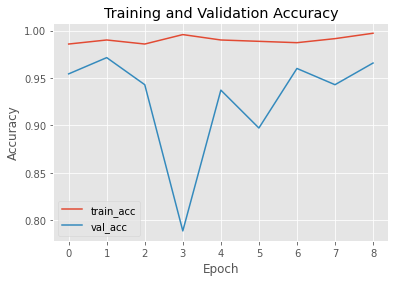

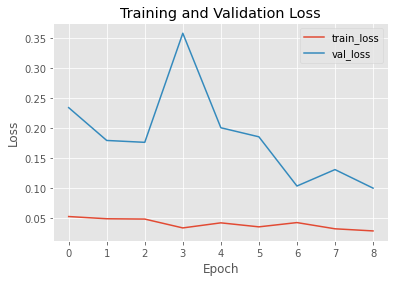

In [0]:
#Graficar precicisión del modelo Xception
plotAccuLost(H, 9)

###H. NasNetMobile

####a. Resumen de las características principales del modelo: Partición utilizada, método de optimización, tamaño de batches, tasa de aprendizaje, etc.


In [0]:
import matplotlib
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing import image_dataset_from_directory

##Variables de imágen
image_size = (224, 224) #image size
batch_size = 32 #baches size
n_epochs = 10 # # epochs

train_ds = tf.keras.preprocessing.image_dataset_from_directory(
    mypath,
    labels="inferred",
    class_names=['covid', 'normal'],
    color_mode="rgb",
    label_mode= "categorical",
    seed=1337,
    validation_split = 0.2,
    subset = "training",
    image_size=image_size,
    batch_size=batch_size,
)

val_ds = tf.keras.preprocessing.image_dataset_from_directory(
    mypath,
    labels="inferred",
    class_names=['covid', 'normal'],
    color_mode="rgb",
    label_mode= "categorical",
    seed=1337,
    validation_split = 0.2,
    subset = "validation",
    image_size=image_size,
    batch_size=batch_size,
)

Found 878 files belonging to 2 classes.
Using 703 files for training.
Found 878 files belonging to 2 classes.
Using 175 files for validation.


In [0]:
#Plot function to be reused to plot model's Accuracy and Loss
def plotAccuLost(model_H, epochs):
  plt.style.use("ggplot")
  #First Plot Training and Validation Accuracy
  plt.figure()
  plt.plot(np.arange(0,epochs),model_H.history["accuracy"],label="train_acc")
  plt.plot(np.arange(0,epochs),model_H.history["val_accuracy"],label="val_acc")
  plt.title("Training and Validation Accuracy")
  plt.xlabel("Epoch")
  plt.ylabel("Accuracy")
  plt.legend()
  #Second Plot Training and Validation Lioss
  plt.figure()
  plt.plot(np.arange(0,epochs),model_H.history["loss"],label="train_loss") 
  plt.plot(np.arange(0,epochs),model_H.history["val_loss"],label="val_loss")
  plt.title("Training and Validation Loss")
  plt.xlabel("Epoch")
  plt.ylabel("Loss")
  plt.legend()
  #Print Plot
  plt.show()

In [0]:
#Separamos las Imágenes y labels del set de val
l = []
i = []
#for each bach
for image,label in val_ds.unbatch():
  l.append(label.numpy().astype(int))
  i.append(image.numpy().astype(int))

val_y = np.array(l)
val_x = np.array(i)
print(val_y.shape)
print(val_x.shape)

(175, 2)
(175, 224, 224, 3)


In [0]:
#Separamos las Imágenes y labels del set de train
l = []
i = []
#for each bach
for image,label in train_ds.unbatch():
  l.append(label.numpy().astype(int))
  i.append(image.numpy().astype(int))

train_y = np.array(l)
train_x = np.array(i)
print(train_y.shape)
print(train_x.shape)

(703, 2)
(703, 224, 224, 3)


In [0]:
# Create the base model from the pre-trained model MobileNet V2
base_model = tf.keras.applications.NASNetMobile(input_shape=image_dimension,
                                               include_top=False, weights='imagenet')
base_model.trainable = False

19996672/19993432 [==============================] - 0s 0us/step


In [0]:
feature_batch = base_model(train_x)
print(feature_batch.shape)

(703, 7, 7, 1056)


In [0]:
base_model.summary()

Model: "NASNet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
stem_conv1 (Conv2D)             (None, 111, 111, 32) 864         input_8[0][0]                    
__________________________________________________________________________________________________
stem_bn1 (BatchNormalization)   (None, 111, 111, 32) 128         stem_conv1[0][0]                 
__________________________________________________________________________________________________
activation_1316 (Activation)    (None, 111, 111, 32) 0           stem_bn1[0][0]                   
_____________________________________________________________________________________________

In [0]:
x = base_model.output
# Adicionando layers de classificion
x = tf.keras.layers.GlobalAveragePooling2D()(x)#name='avg_pool'
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(1268, activation='relu')(x)
x = tf.keras.layers.BatchNormalization()(x)
num_classes = 2
predictions = tf.keras.layers.Dense(num_classes, activation='softmax')(x)
model_nasNetMobile = tf.keras.Sequential()
model_nasNetMobile = tf.keras.models.Model(inputs=base_model.input, outputs=predictions)

In [0]:
base_learning_rate = 0.0001
opt =tf.keras.optimizers.SGD(lr=base_learning_rate,decay=base_learning_rate / 10, momentum=0.9, nesterov=True )
model_nasNetMobile.compile(optimizer= opt,
              loss=tf.keras.losses.binary_crossentropy,
              metrics=['accuracy'])

In [0]:
len(model_nasNetMobile.trainable_variables)

8

####b. Resumen de la arquitectura propuesta.

In [0]:
keras.utils.plot_model(model_nasNetMobile,show_shapes=True)

In [0]:
model_nasNetMobile.summary()

Model: "functional_17"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
stem_conv1 (Conv2D)             (None, 111, 111, 32) 864         input_4[0][0]                    
__________________________________________________________________________________________________
stem_bn1 (BatchNormalization)   (None, 111, 111, 32) 128         stem_conv1[0][0]                 
__________________________________________________________________________________________________
activation_564 (Activation)     (None, 111, 111, 32) 0           stem_bn1[0][0]                   
______________________________________________________________________________________

####c. Tamaño de las imágenes de entrada.

In [0]:
# Establecimos usar estas medidas 224x224x3
image_dimension = (224,224,3)
print(image_dimension)

(224, 224, 3)


####d. Total de pesos del modelo propuesto y tamaño en MB del mismo.

In [0]:
model_nasNetMobile.save_weights('nasNetMobile.model') # 219 MB

In [0]:
#Pesos del Modelo
model_weights = model_nasNetMobile.get_weights()
print(model_weights)

[array([[[[-2.23057866e-01,  5.99932015e-01,  2.29534432e-01,
           8.20063288e-12, -3.72989476e-01, -6.35613133e-12,
          -1.45158961e-01, -4.04257149e-01,  5.04109204e-01,
           4.99138623e-01, -4.24736850e-02,  3.19882601e-01,
           6.44101063e-04,  1.81442335e-01, -3.04567417e-12,
          -9.80089456e-02,  1.01714401e-11, -7.50748595e-12,
          -2.90609114e-02, -3.11470628e-01, -2.15517357e-01,
           3.16776037e-01, -8.05904686e-01,  2.03694284e-01,
          -1.47525430e-01, -8.95422995e-02,  6.32099569e-01,
           5.61665278e-03, -2.26557642e-01,  1.28277719e+00,
          -1.52360468e-11, -6.36123180e-01],
         [-1.05724633e-01,  6.31602645e-01,  9.21697319e-02,
          -4.92292795e-12,  1.31186128e-01, -1.23075985e-12,
           9.82191227e-03,  1.78949967e-01, -3.97206813e-01,
           6.59121513e-01,  4.06046122e-01, -1.23865180e-01,
          -2.89211553e-02,  1.18852831e-01, -4.56298237e-12,
          -2.47097209e-01,  1.04519501e

####e. Tiempo de entrenamiento

In [0]:
import time
#Entrenar modelo e imprimir tiempos
t = time.process_time()
history = model_nasNetMobile.fit(train_ds,
                    epochs=n_epochs,
                    validation_data=val_ds)
print("elapsed_time = ", time.process_time() - t)

Epoch 1/10
22/22 [==============================] - 11s 495ms/step - loss: 0.9158 - accuracy: 0.5576 - val_loss: 0.5837 - val_accuracy: 0.7029
Epoch 2/10
22/22 [==============================] - 11s 497ms/step - loss: 0.4043 - accuracy: 0.8307 - val_loss: 0.4119 - val_accuracy: 0.8629
Epoch 3/10
22/22 [==============================] - 11s 499ms/step - loss: 0.3127 - accuracy: 0.8777 - val_loss: 0.3443 - val_accuracy: 0.8857
Epoch 4/10
22/22 [==============================] - 11s 499ms/step - loss: 0.2779 - accuracy: 0.8919 - val_loss: 0.3015 - val_accuracy: 0.9029
Epoch 5/10
22/22 [==============================] - 11s 503ms/step - loss: 0.2513 - accuracy: 0.8962 - val_loss: 0.2751 - val_accuracy: 0.9029
Epoch 6/10
22/22 [==============================] - 11s 498ms/step - loss: 0.2414 - accuracy: 0.9004 - val_loss: 0.2528 - val_accuracy: 0.9029
Epoch 7/10
22/22 [==============================] - 11s 496ms/step - loss: 0.2186 - accuracy: 0.9090 - val_loss: 0.2343 - val_accuracy: 0.9086

####f. Resumen numérico: precision, recall, f 1-score y matriz de confusión.

In [0]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
score = model_nasNetMobile.evaluate(val_x, val_y, verbose=0, batch_size=batch_size)
print(f'Test loss: {score[0]} / Test accuracy: {score[1]}')

print("Predictions:")
predictions_test = model_nasNetMobile.predict(val_x, batch_size=batch_size)
print(predictions_test[0])

print(classification_report(val_y.argmax(axis=1),
      predictions_test.argmax(axis=1),target_names=["Covid","Normal"]))

Test loss: 0.1950555443763733 / Test accuracy: 0.9371428489685059
Predictions:
[0.0343444 0.9656556]
              precision    recall  f1-score   support

       Covid       0.99      0.88      0.93        80
      Normal       0.90      0.99      0.94        95

    accuracy                           0.94       175
   macro avg       0.94      0.93      0.94       175
weighted avg       0.94      0.94      0.94       175



In [0]:
confusion_matrix(val_y.argmax(axis=1), predictions_test.argmax(axis=1))

array([[70, 10],
       [ 1, 94]])

####g. Gráficas de la precisión (accuracy) y del error de los conjuntos de entrenamiento y prueba.

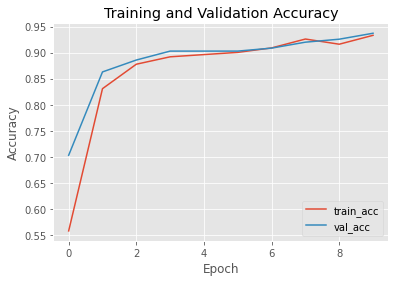

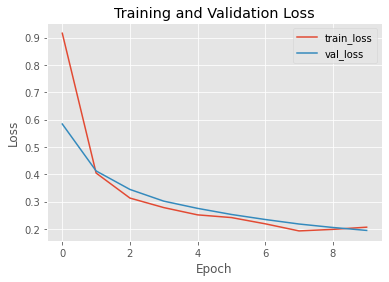

In [0]:
plotAccuLost(history, n_epochs)

###I. EfficientNet

In [0]:
#Modelo EfficientNet
from tensorflow import keras
#Variables del modelo
n_epochs = 10
input_shape=(224, 224, 3)
# Creación del modelo base
base_model = tf.keras.applications.EfficientNetB0(input_shape=input_shape,include_top=False, weights='imagenet')
base_model.trainable = False

x = base_model.output
# Adicionando layers de classificion
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(100, activation='relu')(x)
num_classes = 2
predictions = tf.keras.layers.Dense(num_classes, activation='softmax')(x)
efficientnet_model = tf.keras.Sequential()
efficientnet_model = tf.keras.models.Model(inputs=base_model.input, outputs=predictions)

base_learning_rate = 0.0001
opt =tf.keras.optimizers.SGD(lr=base_learning_rate,decay=base_learning_rate / 10, momentum=0.9, nesterov=True)
efficientnet_model.compile(optimizer= opt, loss=tf.keras.losses.binary_crossentropy, metrics=['accuracy'])

16711680/16705208 [==============================] - 0s 0us/step


####a. Resumen de las características principales del modelo: Partición utilizada, método de optimización, tamaño de batches, tasa de aprendizaje, etc.


**Características principales del Modelo Propuesto:**
* Para este modelo corremos 10 épocas.
* Este modelo emplea el optimizador SGD con un learning rate de 0.0001
* Momentum de 0.9
* Nesterov activo
* El batch size es de 32
* Clasificador de activación "SGD"
* Para la perdida usamos entropía Binaria Cruzada



####b. Resumen de la arquitectura propuesta.

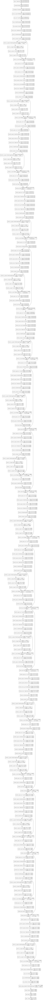

In [0]:
#Resumen de la arquitectura
keras.utils.plot_model(efficientnet_model, show_shapes=True)

In [0]:
#Capas de la arquitectura
efficientnet_model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
rescaling (Rescaling)           (None, 224, 224, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
normalization (Normalization)   (None, 224, 224, 3)  7           rescaling[0][0]                  
__________________________________________________________________________________________________
stem_conv_pad (ZeroPadding2D)   (None, 225, 225, 3)  0           normalization[0][0]              
_______________________________________________________________________________________

####c. Tamaño de las imágenes de entrada.

**Decidimos un tamaño consistente de entrada (224,224,3) es decir son imágenes de 224 x 224 pixeles, y son imágenes a color RGB por eso 3 capas, una por cada color.**


####d. Total de pesos del modelo propuesto y tamaño en MB del mismo.

In [0]:
#Pesos del Modelo
model_weights = efficientnet_model.get_weights()
print(model_weights)

[array([0.485, 0.456, 0.406], dtype=float32), array([0.229, 0.224, 0.225], dtype=float32), 0, array([[[[ 2.07668245e-02,  8.53624821e-01, -9.72171009e-01,
           5.80005467e-01,  3.13335508e-02, -1.81043148e-02,
          -1.28635168e-02,  5.94060645e-02, -7.41896749e-01,
          -2.27897346e-01,  2.00766921e-01, -2.33019665e-02,
          -3.82314444e-01, -1.13366711e+00, -4.97356057e-02,
          -5.28575480e-01,  6.01686649e-02,  3.28413874e-01,
           7.26403654e-01,  9.56093222e-02,  2.53003836e-03,
           7.99428642e-01,  1.60467178e-01,  1.51992925e-02,
           2.15564728e-01, -6.15406692e-01,  7.56446272e-02,
           3.47692966e-02,  0.00000000e+00, -6.27994761e-02,
           2.23197415e-02, -1.42137900e-01],
         [ 1.28902495e-02,  1.56575632e+00, -1.80467033e+00,
           7.77730107e-01,  6.52952865e-02,  2.08790317e-01,
          -8.81190374e-02, -3.78276139e-01,  5.80090940e-01,
          -3.44047934e-01,  6.91463649e-02, -8.79267603e-02,
       

In [0]:
#Descargar el modelo y obtener su tamaño
efficientnet_model.save("efficientnet.hdf5")

**Tamaño del Modelo: 17.04MB**

####e. Tiempo de entrenamiento

In [0]:
#Entrenar modelo e imprimir tiempos
n_epochs = 10
t = time.process_time()
efficientnet_H = efficientnet_model.fit(train_ds, epochs=n_epochs, validation_data=validation_ds)
print("elapsed_time = ", time.process_time() - t)

Epoch 1/10
22/22 [==============================] - 72s 3s/step - loss: 0.3461 - accuracy: 0.8962 - val_loss: 0.2479 - val_accuracy: 0.9600
Epoch 2/10
22/22 [==============================] - 72s 3s/step - loss: 0.3295 - accuracy: 0.9061 - val_loss: 0.2309 - val_accuracy: 0.9600
Epoch 3/10
22/22 [==============================] - 72s 3s/step - loss: 0.3209 - accuracy: 0.9018 - val_loss: 0.2155 - val_accuracy: 0.9657
Epoch 4/10
22/22 [==============================] - 72s 3s/step - loss: 0.2923 - accuracy: 0.9203 - val_loss: 0.2026 - val_accuracy: 0.9657
Epoch 5/10
22/22 [==============================] - 72s 3s/step - loss: 0.2741 - accuracy: 0.9275 - val_loss: 0.1915 - val_accuracy: 0.9657
Epoch 6/10
22/22 [==============================] - 72s 3s/step - loss: 0.2484 - accuracy: 0.9260 - val_loss: 0.1822 - val_accuracy: 0.9657
Epoch 7/10
22/22 [==============================] - 72s 3s/step - loss: 0.2522 - accuracy: 0.9346 - val_loss: 0.1741 - val_accuracy: 0.9657
Epoch 8/10
22/22 [==

**Tiempo total de Entrenamiento: 22 minutos 15 segundos**

####f. Resumen numérico: precision, recall, f 1-score y matriz de confusión.

In [0]:
#Resumen númerico de precision modelo EfficientNet
from sklearn.metrics import classification_report
label_names = ["covid","normal"]
predictions_test = efficientnet_model.predict(images, batch_size=32)
print(classification_report(labels.argmax(axis=1),
      predictions_test.argmax(axis=1), target_names=label_names))

              precision    recall  f1-score   support

       covid       0.99      0.95      0.97        80
      normal       0.96      0.99      0.97        95

    accuracy                           0.97       175
   macro avg       0.97      0.97      0.97       175
weighted avg       0.97      0.97      0.97       175



In [0]:
from sklearn.metrics import confusion_matrix

confusion_matrix(labels.argmax(axis=1), predictions_test.argmax(axis=1))


array([[76,  4],
       [ 1, 94]])

####g. Gráficas de la precisión (accuracy) y del error de los conjuntos de entrenamiento y prueba.

In [0]:
# Evaluate the model on the test data using `evaluate`
print('Evaluation on test data:\n')
loss, accuracy = efficientnet_model.evaluate(validation_ds, batch_size=128, verbose=0)

print('Test loss:', loss)
print('Test acc:', accuracy)


Evaluation on test data:

Test loss: 0.15403103828430176
Test acc: 0.9714285731315613


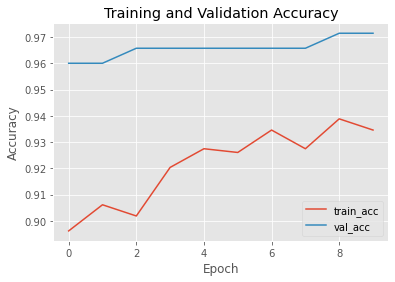

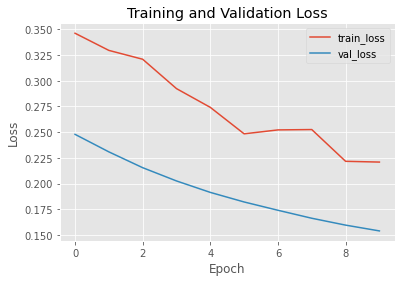

In [0]:
#Graficar precicisión del modelo Xception

plotAccuLost(efficientnet_H, n_epochs)

##3. Resume los resultados obtenidos en el ejercicio anterior en una tabla coparativa e incluye tus conclusiones finales de la actividad.

 ### El Resumen de cada una de las arquitecturas CNN puede encontrasr en el siguiente link: [Arquitecturas CNN](https://docs.google.com/document/d/143J4s2d9U8Dw3E0-X3E6lUpgshuys22TkdPaII1Gx2o/edit?usp=sharing)
 